## Dependências

In [12]:
# Checagem/instalação leve de dependências
print("Verificando dependências (pyarrow para Parquet)...")

try:
    import pyarrow as pa
    print(f"PyArrow disponível: {pa.__version__}")
except Exception:
    print("Instalando pyarrow...")
    !pip install --upgrade "pyarrow>=18" --quiet
    import importlib
    importlib.invalidate_caches()
    import pyarrow as pa
    print(f"PyArrow instalado: {pa.__version__}")

# fastparquet é opcional
try:
    import fastparquet  # noqa: F401
    print("fastparquet disponível (opcional)")
except Exception:
    pass

# Outras bibliotecas sob demanda
for lib in [
    "numpy", "python-dotenv", "pandas", "matplotlib", "seaborn",
    "scikit-learn", "tensorflow", "keras", "lxml", "pytz", "requests", "optuna"
]:
    try:
        __import__(lib)
    except ImportError:
        print(f"Instalando {lib}...")
        !pip install {lib} --quiet

print("Dependências prontas")

Verificando dependências (pyarrow para Parquet)...
PyArrow disponível: 21.0.0
Instalando python-dotenv...


Instalando scikit-learn...



[notice] A new release of pip is available: 24.0 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


Dependências prontas



[notice] A new release of pip is available: 24.0 -> 25.3
[notice] To update, run: python.exe -m pip install --upgrade pip


## VARIÁVEIS NECESSÁRIAS

In [13]:
# Imports para a API e utilidades
import os
import requests
import pandas
from dotenv import load_dotenv
from datetime import datetime, timedelta, date
import pytz
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau
from tensorflow.keras import mixed_precision
import tensorflow as tf

# ==============================================
# GPU CONFIGURATION
# ==============================================
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    for gpu in gpus:
        tf.config.experimental.set_memory_growth(gpu, True)
    mixed_precision.set_global_policy('mixed_float16')
    print(f"✅ GPU detected ({gpus[0].name}) - using mixed precision.")
else:
    print("⚠️ No GPU detected, running on CPU.")

# Carregar variáveis de ambiente do .env
load_dotenv()
# ---------------- CONFIG ---------------- #
COUNTRY_DOMAINS = {
    "FR": {"domain": "10YFR-RTE------C"},
    "ES": {"domain": "10YES-REE------0"},
    "PT": {"domain": "10YPT-REN------W"}
}

DATA_ITEMS = [
    {'key': 'load_total', 'documentType': 'A65', 'processType': 'A16', 'domainParam': 'outBiddingZone_Domain', 'parser': 'load'},
    {'key': 'market_prices', 'documentType': 'A44', 'processType': 'A07', 'domainParamIn': 'in_Domain', 'domainParamOut': 'out_Domain', 'parser': 'price'}
]

ENTSOE_TOKEN = os.environ.get("ENTSOE_SECURITY_TOKEN")
BASE_URL = "https://web-api.tp.entsoe.eu/api"
MAX_WORKERS = 100
RAW_DIR = os.path.join("data", "raw")
PARQUET_COMPRESSION = "zstd"
os.makedirs(RAW_DIR, exist_ok=True)

⚠️ No GPU detected, running on CPU.


# Capítulo 1: Préprocessamento de dados

Etapa de contrução da pipelines de pre-processamento de dados


## Classe geral de preprocessamento

In [14]:
import os
from typing import Optional, List, Tuple
import pandas as pd
from sklearn.preprocessing import MinMaxScaler, StandardScaler, LabelEncoder
import numpy as np
import time

class Preprocessor:
    """Pré-processador base.

    - lag/lead como inteiros são expandidos para ranges [1..N] quando apropriado.
    - feature_cols/target_cols definem bases permitidas e servem como seleção no export.
    - Nenhuma coluna é removida dos dados; seleção ocorre apenas na exportação.
    """
    def __init__(
        self,
        lag: int,
        lead: int,
        country_list: Optional[List[str]] = None,
        *,
        model_name: str = "linear",
        data_dir: str = "data/processed",
        feature_cols: Optional[List[str]] = None,
        target_cols: Optional[List[str]] = None,
    ):
        self.lag = lag
        self.lead = lead
        self.country_list = country_list
        self.model_name = model_name
        self.data_dir = data_dir
        self.save_dir = os.path.join(self.data_dir, self.model_name)
        os.makedirs(self.save_dir, exist_ok=True)

        self.feature_cols: List[str] = list(feature_cols) if feature_cols else []
        self.target_cols: List[str] = list(target_cols) if target_cols else []

        self.norm_objects = {}
        self.encod_objects = {}
        self.df_base = pd.DataFrame()

    def _expand_steps(self, steps, default_max: Optional[int]) -> List[int]:
        """Normaliza passos: int→[1..N], None→[1..default_max], lista→como está."""
        if isinstance(steps, int):
            return list(range(1, steps + 1)) if steps > 0 else [1]
        if steps is None and isinstance(default_max, int) and default_max > 0:
            return list(range(1, default_max + 1))
        if isinstance(steps, (list, tuple)):
            return list(steps)
        return [1]

    def load_data(self, raw_dir: Optional[str] = None) -> pd.DataFrame:
        """Carrega Parquet unificado em data/raw (ou raw_dir) e atualiza self.df_base."""
        base_raw = raw_dir or os.path.join('data', 'raw')
        unified_path = os.path.join(base_raw, f'raw_dataset.parquet')
        if not os.path.exists(unified_path):
            raise FileNotFoundError(f"Arquivo unificado não encontrado: {unified_path}. Execute a coleta primeiro.")
        df = pd.read_parquet(unified_path, engine='pyarrow')
        if 'datetime' in df.columns:
            df['datetime'] = pd.to_datetime(df['datetime'], utc=True)
        if self.country_list and 'country' in df.columns:
            df = df[df['country'].isin(self.country_list)].copy()
        sort_cols = [c for c in ['country', 'datetime'] if c in df.columns]
        if sort_cols:
            df = df.sort_values(sort_cols).reset_index(drop=True)
            
        # Filtrando Colunas apenas para as necessárias
        cols = list(set([c for c in self.feature_cols + self.target_cols if c in df.columns]))
        df = df.loc[:, ~df.columns.duplicated()]  # optional: remove duplicates
        df = df[cols]

        self.df_base = df
        return self.df_base

    def encode(self, encode_cols: str = 'datetime', encode_method: str = 'label') -> pd.DataFrame:
        """Codifica de forma não destrutiva e atualiza self.df_base.

        - label: usa LabelEncoder com suporte a NaN via placeholder interno que é revertido no decode.
        - time_cycle: adiciona features de calendário e cíclicas sem remover datetime.
        """
        if self.df_base is None or self.df_base.empty:
            print("df_base vazio. Chame load_data() primeiro.")
            return self.df_base
        df = self.df_base.copy()
        if encode_method == 'label':
            le = LabelEncoder()
            s = df[encode_cols].astype(object)
            le.fit(s)
            df[encode_cols] = le.transform(s)
            # salva metadados incluindo o code do NaN
            self.encod_objects['label'] = {
                'encode_cols': encode_cols,
                'label_encoder': le,
            }
        elif encode_method == 'time_cycle':
            if encode_cols not in df.columns:
                print(f"Coluna {encode_cols} não encontrada para time_cycle.")
                self.df_base = df
                return df
            dt = pd.to_datetime(df[encode_cols], utc=True)
            # Mantém a coluna original e adiciona componentes discretos e cíclicos
            df['year'] = dt.dt.year
            df['month'] = dt.dt.month
            df['day'] = dt.dt.day
            df['hour'] = dt.dt.hour
            df['minute'] = dt.dt.minute
            current_year = time.localtime().tm_year
            df['year_sin'] = np.sin(2 * np.pi * df['year'] / max(current_year, 1))
            df['year_cos'] = np.cos(2 * np.pi * df['year'] / max(current_year, 1))
            df['month_sin'] = np.sin(2 * np.pi * df['month'] / 12)
            df['month_cos'] = np.cos(2 * np.pi * df['month'] / 12)
            df['day_sin'] = np.sin(2 * np.pi * df['day'] / 31)
            df['day_cos'] = np.cos(2 * np.pi * df['day'] / 31)
            df['hour_sin'] = np.sin(2 * np.pi * df['hour'] / 24)
            df['hour_cos'] = np.cos(2 * np.pi * df['hour'] / 24)
            df['minute_sin'] = np.sin(2 * np.pi * df['minute'] / 60)
            df['minute_cos'] = np.cos(2 * np.pi * df['minute'] / 60)
            self.encod_objects['time_cycle'] = {'encode_cols': encode_cols}
            self.feature_cols.extend(["year_sin", "year_cos",
                                                     "month_sin", "month_cos",
                                                     "day_sin", "day_cos",
                                                     "hour_sin", "hour_cos",
                                                     "minute_sin", "minute_cos"])
        else:
            print(f"encode_method '{encode_method}' não suportado.")
        self.df_base = df
        return self.df_base

    def decode(self, encode_method: str = 'label', target_col: Optional[str] = None) -> pd.DataFrame:
        """Reverte codificações suportadas (label, time_cycle)."""
        if self.df_base is None or self.df_base.empty:
            print("df_base vazio. Nada para decodificar.")
            return self.df_base
        df = self.df_base.copy()
        if encode_method == 'label':
            info = self.encod_objects.get('label')
            if not info:
                print("Nenhuma informação de label encoding salva.")
                return self.df_base
            col = info['encode_cols']
            le: LabelEncoder = info['label_encoder']
            placeholder = info.get('na_placeholder', '__NA__')
            try:
                inv = le.inverse_transform(df[col].astype(int))
                # mapeia placeholder de volta para NaN
                inv = pd.Series(inv).replace(placeholder, np.nan).values
                df[col] = inv
            except Exception as e:
                print(f"Falha ao decodificar label para coluna {col}: {e}")
        elif encode_method == 'time_cycle':
            if 'year' not in df.columns:
                print("Componentes de tempo ausentes para reconstrução.")
                return self.df_base
            tgt = target_col or 'decoded_datetime'
            def _recover_component(sin_col, cos_col, period, offset):
                if sin_col not in df.columns or cos_col not in df.columns:
                    return pd.Series([np.nan] * len(df))
                ang = np.arctan2(df[sin_col], df[cos_col])
                ang = (ang + 2 * np.pi) % (2 * np.pi)
                idx = np.round((ang / (2 * np.pi)) * period).astype('Int64') % period
                return idx + offset
            month = _recover_component('month_sin', 'month_cos', 12, 1)
            day = _recover_component('day_sin', 'day_cos', 31, 1)
            hour = _recover_component('hour_sin', 'hour_cos', 24, 0)
            minute = _recover_component('minute_sin', 'minute_cos', 60, 0)
            year = df['year'] if 'year' in df.columns else pd.Series([np.nan] * len(df))
            dt = pd.to_datetime({
                'year': year.astype('Int64'),
                'month': month.astype('Int64'),
                'day': day.astype('Int64'),
                'hour': hour.astype('Int64'),
                'minute': minute.astype('Int64'),
            }, errors='coerce', utc=True)
            df[tgt] = dt
        else:
            print(f"encode_method '{encode_method}' não suportado para decode.")
        self.df_base = df
        return self.df_base

    def normalize(self, value_cols: List[str], normalization_method: str = 'minmax') -> pd.DataFrame:
        """Normaliza colunas e atualiza self.df_base."""
        if self.df_base is None or self.df_base.empty:
            print("df_base vazio. Chame load_data() primeiro.")
            return self.df_base
        df = self.df_base.copy()
        scaler = MinMaxScaler() if normalization_method == 'minmax' else (
            StandardScaler() if normalization_method == 'standard' else None)
        if scaler is None:
            raise ValueError("normalization_method deve ser 'minmax' ou 'standard'")
        df[value_cols] = scaler.fit_transform(df[value_cols])
        self.norm_objects[normalization_method] = {'value_cols': value_cols, 'scaler': scaler}
        self.df_base = df
        return self.df_base

    def normalize_splits(self, value_cols: List[str], normalization_method: str = 'minmax') -> dict:
        """Normaliza os conjuntos de treino, validação e teste."""
        if not self.splits:
            print("Nenhum conjunto dividido encontrado.")
            return {}
        normalized_splits = {}
        for split_name, split_df in self.splits.items():
            self.df_base = split_df
            normalized_df = self.normalize(value_cols=value_cols, normalization_method=normalization_method)
            normalized_splits[split_name] = normalized_df
        self.splits = normalized_splits
        return normalized_splits

    def denormalize(self, normalization_method: str = 'minmax') -> pd.DataFrame:
        """Reverte normalização usando metadados salvos."""
        if self.df_base is None or self.df_base.empty:
            print("df_base vazio. Nada para denormalizar.")
            return self.df_base
        info = self.norm_objects.get(normalization_method)
        if not info:
            print(f"Nenhum scaler salvo para o método '{normalization_method}'.")
            return self.df_base
        cols: List[str] = info['value_cols']
        scaler = info['scaler']
        df = self.df_base.copy()
        try:
            df[cols] = scaler.inverse_transform(df[cols])
        except Exception as e:
            print(f"Falha ao denormalizar colunas {cols}: {e}")
            return self.df_base
        self.df_base = df
        return self.df_base

    def save_df_base(self, filename: Optional[str] = None, compression: Optional[str] = None, partition_by: Optional[List[str]] = None) -> Optional[str]:
        """Salva self.df_base em Parquet dentro de data_dir/{model_name}."""
        if self.df_base is None or self.df_base.empty:
            print("df_base vazio. Nada para salvar.")
            return None
        comp = compression
        if comp is None:
            try:
                comp = PARQUET_COMPRESSION
            except NameError:
                comp = 'zstd'
        filename = "raw_dataset.parquet"
        out_path = os.path.join(self.save_dir, filename)
        df = self.df_base.copy()
        if 'datetime' in df.columns:
            df['datetime'] = pd.to_datetime(df['datetime'], utc=True)
        try:
            if partition_by:
                df.to_parquet(out_path, engine='pyarrow', compression=comp, index=False, partition_cols=partition_by)
            else:
                df.to_parquet(out_path, engine='pyarrow', compression=comp, index=False)
            print(f"[SALVO] df_base: {len(df):,} linhas → {out_path}")
            return out_path
        except Exception as e:
            print(f"Falha ao salvar df_base em {out_path}: {e}")
            return None
    
    def split_train_val_test(self, train_size: float = 0.7, val_size: float = 0.15, test_size: float = 0.15, time_col: str = 'datetime') -> Optional[dict]:
        """Divide df_base em conjuntos de treino, validação e teste com base em time_col."""
        if self.df_base is None or self.df_base.empty:
            print("df_base vazio. Nada para dividir.")
            return None
        if not np.isclose(train_size + val_size + test_size, 1.0):
            print("train_size, val_size e test_size devem somar 1.0")
            return None
        df = self.df_base.copy()
        if time_col not in df.columns:
            print(f"Coluna de tempo '{time_col}' não encontrada em df_base.")
            return None
        df = df.sort_values(time_col).reset_index(drop=True)
        n = len(df)
        train_end = int(n * train_size)
        val_end = train_end + int(n * val_size)
        splits = {
            'train': df.iloc[:train_end].reset_index(drop=True),
            'val': df.iloc[train_end:val_end].reset_index(drop=True),
            'test': df.iloc[val_end:].reset_index(drop=True),
        }
        for split_name, split_df in splits.items():
            print(f"[DIVIDIDO] {split_name}: {len(split_df):,} linhas")
        self.splits = splits
        return splits

## Preprocessamento do Modelo Linear

Esse modelo deve será contruido a partir de lags e leads passados como parâmetros na função, resultando na contrução de novas colunas lead lag, assim gerando uma flat matrix 2D que será usada no modelo linear

Observação importante: lag e lead são inteiros e representam o máximo de passos; o pipeline expande para intervalos 1..N automaticamente. Por exemplo, lag=96 gera features com defasagens de 1 a 96; lead=96 gera alvos de 1 a 96.

Os arquivos do modelo serão salvos em TFrecords já que o modelo linear será contruído usando tensor flow

In [15]:
class LinearPreprocessor(Preprocessor):
    """Pré-processador linear: gera matriz flat (lags/leads), exporta Parquet e TFRecords."""

    def build_flat_matrix(
        self,
        value_cols: Optional[List[str]] = None,
        target_cols: Optional[List[str]] = None,
        lags: Optional[int] = None,
        leads: Optional[int] = None,
        dropna: bool = True,
        group_cols: Optional[List[str]] = None,
        time_col: str = "datetime",
    ) -> pd.DataFrame:
        import pandas as pd

        if self.df_base is None or self.df_base.empty:
            print("df_base vazio. Chame load_data() primeiro.")
            return self.df_base

        df = self.df_base.copy()
        feats = value_cols or self.feature_cols
        tgts = target_cols or self.target_cols
        if not feats:
            raise ValueError("Nenhuma coluna de feature informada.")
        if not tgts:
            raise ValueError("Nenhum target informado.")

        group_cols = group_cols or [c for c in ["country"] if c in df.columns]

        if time_col not in df.columns:
            raise ValueError(f"Coluna temporal '{time_col}' não encontrada no DataFrame.")

        sort_cols = (group_cols or []) + [time_col]
        df = df.sort_values(sort_cols).reset_index(drop=True)

        if group_cols:
            df["_group_id"] = df[group_cols].astype(str).agg("_".join, axis=1)
        else:
            df["_group_id"] = "global"

        lag_steps = list(range(1, (lags or self.lag or 0) + 1))
        lead_steps = list(range(1, (leads or self.lead or 0) + 1))
        new_cols = []

        # ---- Lags ----
        for col in feats:
            if col not in df.columns:
                print(f"[WARN] Coluna de feature '{col}' não encontrada.")
                continue
            for k in lag_steps:
                cname = f"{col}_lag{k}"
                df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[col].shift(k)
                new_cols.append(cname)

        # ---- Leads ----
        for tgt in tgts:
            if tgt in df.columns:
                for k in lead_steps:
                    cname = f"{tgt}_lead{k}"
                    df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[tgt].shift(-k)
                    new_cols.append(cname)
            else:
                print(f"[WARN] Target '{tgt}' não encontrado. Ignorando leads.")

        if dropna and new_cols:
            df = df.dropna(subset=new_cols).reset_index(drop=True)

        df.drop(columns=["_group_id"], inplace=True, errors="ignore")

        self.df_base = df
        self.feature_cols.extend([c for c in new_cols if "_lag" in c and c not in self.feature_cols])
        self.target_cols.extend([c for c in new_cols if "_lead" in c and c not in self.target_cols])
        return self.df_base

    def build_flat_matrices_splits(self, *args, **kwargs) -> Optional[dict]:
        """Constrói matrizes flat para cada split (train/val/test)."""
        if not self.splits:
            print("Nenhum conjunto dividido encontrado.")
            return None
        built_splits = {}
        for split_name, split_df in self.splits.items():
            self.df_base = split_df
            built_df = self.build_flat_matrix(*args, **kwargs)
            built_splits[split_name] = built_df
        self.splits = built_splits
        return built_splits

    def save_tfrecords(
        self,
        output_basename: str = 'dataset',
        shard_size: int = 100_000,
        compression: Optional[str] = None,
    ) -> Optional[List[str]]:
        import os, json
        import pandas as pd
        import tensorflow as tf

        if self.df_base is None or self.df_base.empty:
            print("df_base vazio. Nada para salvar em TFRecords.")
            return None

        # --- Salvar Parquet intermediário ---
        parquet_path = os.path.join(self.save_dir, f"{output_basename}.parquet")
        try:
            self.df_base.to_parquet(parquet_path, index=False)
            print(f"[💾] Parquet salvo em: {parquet_path}")
        except Exception as e:
            print(f"[WARN] Falha ao salvar Parquet: {e}")

        # --- Seleção de colunas numéricas ---
        numeric_cols = self.df_base.select_dtypes(include=["number", "bool"]).columns
        present_feats = [c for c in self.feature_cols if c in numeric_cols]
        present_tgts = [c for c in self.target_cols if c in numeric_cols]
        if not present_feats or not present_tgts:
            print("Nenhuma feature/target válida encontrada. Abortando export.")
            return None
        
        self.feature_cols = present_feats
        self.target_cols = present_tgts

        df = self.df_base.reset_index(drop=True)
        X = df[present_feats].astype('float32').to_numpy(copy=False)
        y = df[present_tgts].astype('float32').to_numpy(copy=False)
        n = len(df)
        x_dim, y_dim = X.shape[1], y.shape[1]

        comp = compression or 'GZIP'
        options = tf.io.TFRecordOptions(compression_type=comp)
        paths: List[str] = []

        def _float_feature(v):
            return tf.train.Feature(float_list=tf.train.FloatList(value=v))

        for shard_idx, start in enumerate(range(0, n, shard_size)):
            end = min(start + shard_size, n)
            shard_path = os.path.join(self.save_dir, f"{output_basename}_{shard_idx}.tfrecord")
            with tf.io.TFRecordWriter(shard_path, options=options) as w:
                for i in range(start, end):
                    ex = tf.train.Example(features=tf.train.Features(feature={
                        'x': _float_feature(X[i]),
                        'y': _float_feature(y[i]),
                    }))
                    w.write(ex.SerializeToString())
            paths.append(shard_path)

        # --- Metadados ---
        meta = {
            'x_dim': int(x_dim),
            'y_dim': int(y_dim),
            'feature_cols': present_feats,
            'target_cols': present_tgts,
            'count': int(n),
            'compression': comp,
            'basename': output_basename,
            'parquet_path': parquet_path,
        }
        try:
            with open(os.path.join(self.save_dir, f"{output_basename}.meta.json"), 'w', encoding='utf-8') as f:
                json.dump(meta, f, ensure_ascii=False, indent=2)
        except Exception as e:
            print(f"[WARN] Falha ao salvar metadados: {e}")

        print(f"[✅] TFRecords salvos ({len(paths)} shards) + Parquet em {self.save_dir}")
        return paths

    def save_splits_tfrecords(
        self,
        output_basename: str = 'dataset',
        shard_size: int = 100_000,
        compression: Optional[str] = None,
    ) -> Optional[dict]:
        """Salva TFRecords e Parquet para cada split (train/val/test)."""
        if not self.splits:
            print("Nenhum conjunto dividido encontrado.")
            return None
        paths_dict = {}
        for split_name, split_df in self.splits.items():
            self.df_base = split_df
            paths = self.save_tfrecords(
                output_basename=f"{output_basename}_{split_name}",
                shard_size=shard_size,
                compression=compression,
            )
            paths_dict[split_name] = paths
        return paths_dict


# Capítulo 2 — Construção dos Modelos

A seguir, definimos construtores simples e eficientes para cada modelo (Linear, LSTM, TFT e TimesFM),
prontos para uso em rotinas de otimização de hiperparâmetros (por exemplo, Optuna). Cada construtor
recebe um dicionário de parâmetros (`params`) e retorna um modelo compilado.

## Construção do Modelo Linear

Objetivo: um regressor denso simples (MLP) para prever `target_cols` a partir de `feature_cols`.

Contrato rápido:
- Entrada: vetor de tamanho `x_dim` (número de features)
- Saída: vetor de tamanho `y_dim` (número de targets)
- Parâmetros (exemplos): hidden_units, activation, dropout, lr, l2

In [16]:
from typing import Dict, Any
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers


def build_linear_model(x_dim: int, y_dim: int, params: Dict[str, Any]) -> keras.Model:
    """Constrói um MLP simples para regressão multivariada.

    params:
      - hidden_units: List[int]
      - activation: str (ex.: 'relu')
      - dropout: float (0..1)
      - l2: float (regularização L2)
      - lr: float (learning rate)
    """
    hidden_units = params.get('hidden_units', [128, 64])
    activation = params.get('activation', 'relu')
    dropout = float(params.get('dropout', 0.0))
    l2 = float(params.get('l2', 0.0))
    lr = float(params.get('lr', 1e-3))

    inputs = keras.Input(shape=(x_dim,), name='features')
    x = inputs
    for i, units in enumerate(hidden_units):
        x = layers.Dense(units, activation=activation,
                         kernel_regularizer=keras.regularizers.l2(l2),
                         name=f'dense_{i}')(x)
        if dropout > 0:
            x = layers.Dropout(dropout, name=f'dropout_{i}')(x)
    outputs = layers.Dense(y_dim, name='targets')(x)

    model = keras.Model(inputs, outputs, name='linear_mlp')
    model.compile(optimizer=keras.optimizers.Adam(learning_rate=lr),
                  loss='mse', metrics=['mae'])
    return model

# Funções auxiliares para carregar TFRecords
def parse_tfrecord(example_proto, x_dim, y_dim):
    feature_description = {
        'x': tf.io.VarLenFeature(tf.float32),
        'y': tf.io.VarLenFeature(tf.float32),
    }
    parsed = tf.io.parse_single_example(example_proto, feature_description)
    x = tf.sparse.to_dense(parsed['x'])
    y = tf.sparse.to_dense(parsed['y'])
    x = tf.reshape(x, [x_dim])
    y = tf.reshape(y, [y_dim])
    return x, y

def load_tfrecord_dataset(path_pattern, x_dim, y_dim, batch_size=64, compression='GZIP'):
    files = tf.io.gfile.glob(path_pattern)
    ds = tf.data.TFRecordDataset(files, compression_type=compression)
    ds = ds.map(lambda x: parse_tfrecord(x, x_dim, y_dim),
                num_parallel_calls=tf.data.AUTOTUNE)
    ds = ds.batch(batch_size).prefetch(tf.data.AUTOTUNE)
    return ds

# Capítulo 3 - Contrução da Pipelines de dados dos modelos

Contruir o fluxo de dados, incluindo a o preprocessamento e treinamento dos modelos

## Pipeline dos Modelos Lineares

Será gerada uma pipeline completa para cada nível de pergunta

Cada função irá processar os dados para cad problema e fazer o treinamento do modelo

Seus outputs serão os modelos treinados, onde os valores serão comparados ao final do modelo

In [17]:
import optuna
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

def linear_pipeline(
    data_dir: str,
    country_list: List[str],
    feature_cols: List[str],
    target_cols: List[str],
    lag: int,
    lead: int,
    value_cols: List[str],
    use_optuna: bool = True,
    n_trials: int = 20,
    batch_size: int = 128
) -> Tuple[LinearPreprocessor, keras.Model]:
    
    # ----------------------------
    # Pré-processamento
    # ----------------------------
    preproc = LinearPreprocessor(
        data_dir=data_dir,
        model_name='linear_model',
        feature_cols=feature_cols,
        target_cols=target_cols,
        lag=lag,
        lead=lead,
        country_list=country_list
    )
    
    preproc.load_data()
    preproc.encode(encode_cols='datetime', encode_method='time_cycle')
    preproc.encode(encode_cols='country', encode_method='label')
    preproc.split_train_val_test(train_size=0.6, val_size=0.2, test_size=0.2, time_col='datetime')
    preproc.normalize_splits(value_cols=value_cols, normalization_method='minmax')
    preproc.build_flat_matrices_splits(
        value_cols=value_cols,
        target_cols=target_cols,
        dropna=True,
        group_cols=['country'],
        time_col='datetime' 
    )
    preproc.save_splits_tfrecords(output_basename='linear_dataset', shard_size=1000, compression='GZIP')
    print("Pré-processamento linear concluído.")

    # ----------------------------
    # TFRecord datasets
    # ----------------------------
    x_dim = len(preproc.feature_cols)
    y_dim = len(preproc.target_cols)

    dataset_train = load_tfrecord_dataset(
        path_pattern=os.path.join(preproc.save_dir, 'linear_dataset_train*.tfrecord'),
        x_dim=x_dim, y_dim=y_dim, batch_size=batch_size
    )
    dataset_val = load_tfrecord_dataset(
        path_pattern=os.path.join(preproc.save_dir, 'linear_dataset_val*.tfrecord'),
        x_dim=x_dim, y_dim=y_dim, batch_size=batch_size
    )
    print("Dataset TFRecord carregado para treinamento.")

    # ----------------------------
    # Optuna hyperparameter search
    # ----------------------------
    if use_optuna:
        def objective(trial):
            # Hyperparameters
            hidden_layers = trial.suggest_int("n_layers", 1, 3)
            hidden_units = [trial.suggest_int(f"units_l{i}", 32, 512, step=32) for i in range(hidden_layers)]
            activation = trial.suggest_categorical("activation", ["relu", "tanh", "leaky_relu"])
            dropout = trial.suggest_float("dropout", 0.0, 0.3)
            l2 = trial.suggest_float("l2", 1e-6, 1e-3, log=True)
            lr = trial.suggest_float("lr", 1e-4, 1e-2, log=True)
            n_epochs = trial.suggest_int("n_epochs", 50, 100)

            params = {
                "hidden_units": hidden_units,
                "activation": activation,
                "dropout": dropout,
                "l2": l2,
                "lr": lr
            }

            model = build_linear_model(x_dim=x_dim, y_dim=y_dim, params=params)

            # Callbacks
            early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True, verbose=0)

            history = model.fit(
                dataset_train,
                validation_data=dataset_val,
                epochs=n_epochs,
                callbacks=[early_stopping],
                verbose=0
            )
            return min(history.history['val_loss'])

        study = optuna.create_study(direction="minimize")
        study.optimize(objective, n_trials=n_trials, n_jobs=-1)
        print("Melhores hiperparâmetros Optuna:", study.best_params)

        # Reconstruir modelo final com melhores hiperparâmetros
        best_params = study.best_params
        hidden_layers = best_params.pop("n_layers")
        hidden_units = [best_params.pop(f"units_l{i}") for i in range(hidden_layers)]
        best_params["hidden_units"] = hidden_units
    else:
        # Valores default
        best_params = {'hidden_units':[128,64], 'activation':'relu', 'dropout':0.1, 'l2':1e-6, 'lr':1e-3}

    # ----------------------------
    # Construção do modelo final
    # ----------------------------
    model = build_linear_model(x_dim=x_dim, y_dim=y_dim, params=best_params)

    # Callbacks finais
    early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True, verbose=0)
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=1e-6, verbose=0)

    model.fit(dataset_train, validation_data=dataset_val, epochs=100, callbacks=[early_stopping, reduce_lr])

    # ----------------------------
    # Plot histórico
    # ----------------------------
    import matplotlib.pyplot as plt
    plt.figure(figsize=(12, 4))
    for key in model.history.history.keys():
        plt.plot(model.history.history[key], label=key)
    plt.title("Histórico de Treinamento")
    plt.xlabel("Época")
    plt.ylabel("Valor")
    plt.legend()
    plt.show()

    return preproc, model



🚀 Running pipeline Nivel 1 - A ...
[DIVIDIDO] train: 10,357 linhas
[DIVIDIDO] val: 3,452 linhas
[DIVIDIDO] test: 3,454 linhas


C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[col].shift(k)
C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[col].shift(k)
C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

[💾] Parquet salvo em: data/N1A\linear_model\linear_dataset_train.parquet
[✅] TFRecords salvos (10 shards) + Parquet em data/N1A\linear_model
[💾] Parquet salvo em: data/N1A\linear_model\linear_dataset_val.parquet
[✅] TFRecords salvos (3 shards) + Parquet em data/N1A\linear_model
[💾] Parquet salvo em: data/N1A\linear_model\linear_dataset_test.parquet
[✅] TFRecords salvos (3 shards) + Parquet em data/N1A\linear_model
Pré-processamento linear concluído.
Dataset TFRecord carregado para treinamento.


[I 2025-10-31 09:05:42,744] A new study created in memory with name: no-name-4f90e972-3f05-4266-90e9-840205a482e4
c:\Users\victo\OneDrive\Documentos\TCC\TCC-2025\tfc_venv\Lib\site-packages\keras\src\trainers\epoch_iterator.py:164: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()
[I 2025-10-31 09:06:18,804] Trial 8 finished with value: 0.05151863023638725 and parameters: {'n_layers': 1, 'units_l0': 64, 'activation': 'relu', 'dropout': 0.2767644045238185, 'l2': 8.684339620211902e-06, 'lr': 0.006283999666264448, 'n_epochs': 78}. Best is trial 8 with value: 0.05151863023638725.
[I 2025-10-31 09:06:30,312] Trial 1 finished with value: 0.05284165218472481 and parameters: {'n_layers': 1, 'units_l0': 512, 'activation': 'tanh', 'dropout': 0.23924163461092438, 'l2': 8.21464520386664

Melhores hiperparâmetros Optuna: {'n_layers': 1, 'units_l0': 480, 'activation': 'leaky_relu', 'dropout': 0.14434063139309958, 'l2': 1.760804120883254e-06, 'lr': 0.0012619164716416084, 'n_epochs': 94}
Epoch 1/100
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.1097 - mae: 0.2398 - val_loss: 0.0481 - val_mae: 0.1805 - learning_rate: 0.0013
Epoch 2/100
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0279 - mae: 0.1306 - val_loss: 0.0405 - val_mae: 0.1651 - learning_rate: 0.0013
Epoch 3/100
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0215 - mae: 0.1138 - val_loss: 0.0330 - val_mae: 0.1477 - learning_rate: 0.0013
Epoch 4/100
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0195 - mae: 0.1081 - val_loss: 0.0276 - val_mae: 0.1345 - learning_rate: 0.0013
Epoch 5/100
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0177 - mae: 0.1025 - val_loss: 0.0234 - val_mae: 0.1225 - learning_rate: 0.0013
Epoch 6/100
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0178 - mae: 0.1030 - val_loss: 0.0

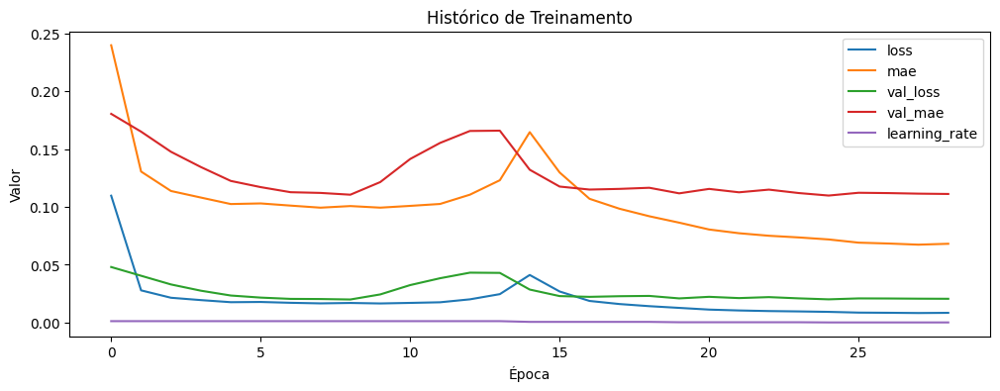

✅ Finished Nivel 1 - A - memory cleared
------------------------------------------------------------

🚀 Running pipeline Nivel 1 - B ...
[DIVIDIDO] train: 24,222 linhas
[DIVIDIDO] val: 8,074 linhas
[DIVIDIDO] test: 8,075 linhas


C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[col].shift(k)
C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[col].shift(k)
C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

[💾] Parquet salvo em: data/N1B\linear_model\linear_dataset_train.parquet
[✅] TFRecords salvos (20 shards) + Parquet em data/N1B\linear_model
[💾] Parquet salvo em: data/N1B\linear_model\linear_dataset_val.parquet
[✅] TFRecords salvos (4 shards) + Parquet em data/N1B\linear_model
[💾] Parquet salvo em: data/N1B\linear_model\linear_dataset_test.parquet


[I 2025-10-31 09:08:24,625] A new study created in memory with name: no-name-59934301-9e67-467c-bddf-24680145808e


[✅] TFRecords salvos (3 shards) + Parquet em data/N1B\linear_model
Pré-processamento linear concluído.
Dataset TFRecord carregado para treinamento.


c:\Users\victo\OneDrive\Documentos\TCC\TCC-2025\tfc_venv\Lib\site-packages\keras\src\trainers\epoch_iterator.py:164: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()
[I 2025-10-31 09:09:35,056] Trial 11 finished with value: 0.00699608214199543 and parameters: {'n_layers': 1, 'units_l0': 64, 'activation': 'leaky_relu', 'dropout': 0.14158212901313563, 'l2': 1.3505483723841338e-06, 'lr': 0.005183764526874783, 'n_epochs': 67}. Best is trial 11 with value: 0.00699608214199543.
[I 2025-10-31 09:09:40,850] Trial 4 finished with value: 0.007244015112519264 and parameters: {'n_layers': 1, 'units_l0': 384, 'activation': 'leaky_relu', 'dropout': 0.034772508781222664, 'l2': 1.5014000220354502e-06, 'lr': 0.003691826319176731, 'n_epochs': 90}. Best is trial 11 with value: 0.006996082141

Melhores hiperparâmetros Optuna: {'n_layers': 3, 'units_l0': 32, 'units_l1': 384, 'units_l2': 128, 'activation': 'relu', 'dropout': 0.06027020067435898, 'l2': 3.949632445759508e-06, 'lr': 0.0001506321728172232, 'n_epochs': 78}
Epoch 1/100
75/75 ━━━━━━━━━━━━━━━━━━━━ 2s 10ms/step - loss: 0.2036 - mae: 0.3556 - val_loss: 0.0460 - val_mae: 0.1553 - learning_rate: 1.5063e-04
Epoch 2/100
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0338 - mae: 0.1351 - val_loss: 0.0103 - val_mae: 0.0799 - learning_rate: 1.5063e-04
Epoch 3/100
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0204 - mae: 0.1067 - val_loss: 0.0097 - val_mae: 0.0781 - learning_rate: 1.5063e-04
Epoch 4/100
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 10ms/step - loss: 0.0169 - mae: 0.0976 - val_loss: 0.0092 - val_mae: 0.0763 - learning_rate: 1.5063e-04
Epoch 5/100
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 11ms/step - loss: 0.0150 - mae: 0.0923 - val_loss: 0.0091 - val_mae: 0.0756 - learning_rate: 1.5063e-04
Epoch 6/100
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 10

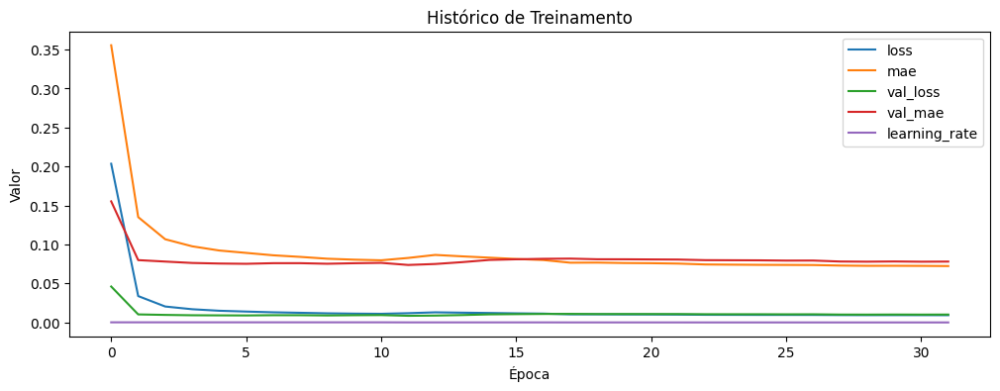

✅ Finished Nivel 1 - B - memory cleared
------------------------------------------------------------

🚀 Running pipeline Nivel 1 - C ...
[DIVIDIDO] train: 24,222 linhas
[DIVIDIDO] val: 8,074 linhas
[DIVIDIDO] test: 8,075 linhas


C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[col].shift(k)
C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[col].shift(k)
C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

[💾] Parquet salvo em: data/N1C\linear_model\linear_dataset_train.parquet
[✅] TFRecords salvos (15 shards) + Parquet em data/N1C\linear_model
[💾] Parquet salvo em: data/N1C\linear_model\linear_dataset_val.parquet
[✅] TFRecords salvos (1 shards) + Parquet em data/N1C\linear_model
df_base vazio. Nada para salvar em TFRecords.
Pré-processamento linear concluído.


[I 2025-10-31 09:14:43,497] A new study created in memory with name: no-name-3e027c30-8cf5-4767-ad11-6ed64992f04b


Dataset TFRecord carregado para treinamento.


c:\Users\victo\OneDrive\Documentos\TCC\TCC-2025\tfc_venv\Lib\site-packages\keras\src\trainers\epoch_iterator.py:164: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()
[I 2025-10-31 09:16:28,557] Trial 1 finished with value: 0.08315497636795044 and parameters: {'n_layers': 2, 'units_l0': 96, 'units_l1': 288, 'activation': 'tanh', 'dropout': 0.25651016116476666, 'l2': 6.669689140786313e-06, 'lr': 0.001228353696120064, 'n_epochs': 96}. Best is trial 1 with value: 0.08315497636795044.
[I 2025-10-31 09:17:02,873] Trial 2 finished with value: 0.0073498510755598545 and parameters: {'n_layers': 1, 'units_l0': 96, 'activation': 'leaky_relu', 'dropout': 0.04265009495395093, 'l2': 1.7698441919915408e-05, 'lr': 0.002372504595154685, 'n_epochs': 53}. Best is trial 2 with value: 0.007349

Melhores hiperparâmetros Optuna: {'n_layers': 1, 'units_l0': 96, 'activation': 'leaky_relu', 'dropout': 0.04265009495395093, 'l2': 1.7698441919915408e-05, 'lr': 0.002372504595154685, 'n_epochs': 53}
Epoch 1/100
57/57 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0784 - mae: 0.1790 - val_loss: 0.0156 - val_mae: 0.0915 - learning_rate: 0.0024
Epoch 2/100
57/57 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0147 - mae: 0.0854 - val_loss: 0.0219 - val_mae: 0.1128 - learning_rate: 0.0024
Epoch 3/100
57/57 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0170 - mae: 0.0953 - val_loss: 0.0140 - val_mae: 0.0882 - learning_rate: 0.0024
Epoch 4/100
57/57 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0130 - mae: 0.0798 - val_loss: 0.0143 - val_mae: 0.0889 - learning_rate: 0.0024
Epoch 5/100
57/57 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0119 - mae: 0.0754 - val_loss: 0.0143 - val_mae: 0.0891 - learning_rate: 0.0024
Epoch 6/100
57/57 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step - loss: 0.0115 - mae: 0.0738 - val_loss: 0.01

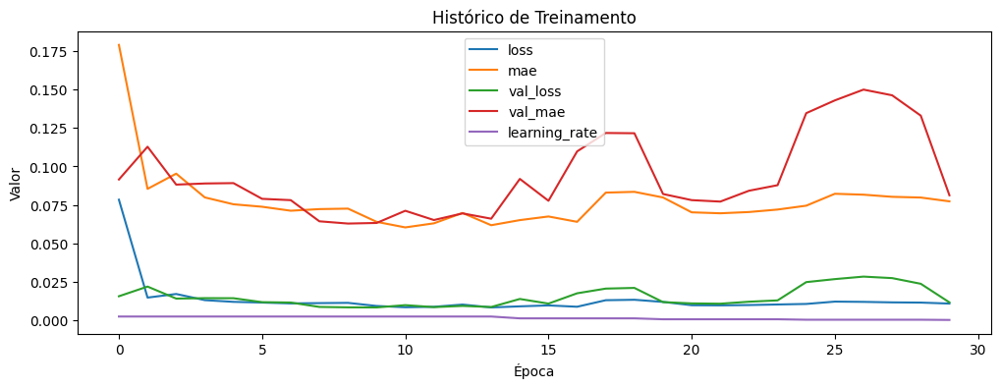

✅ Finished Nivel 1 - C - memory cleared
------------------------------------------------------------

🚀 Running pipeline Nivel 2 - A ...
[DIVIDIDO] train: 10,357 linhas
[DIVIDIDO] val: 3,452 linhas
[DIVIDIDO] test: 3,454 linhas


C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[col].shift(k)
C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[col].shift(k)
C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

[💾] Parquet salvo em: data/N2A\linear_model\linear_dataset_train.parquet
[✅] TFRecords salvos (10 shards) + Parquet em data/N2A\linear_model
[💾] Parquet salvo em: data/N2A\linear_model\linear_dataset_val.parquet
[✅] TFRecords salvos (3 shards) + Parquet em data/N2A\linear_model
[💾] Parquet salvo em: data/N2A\linear_model\linear_dataset_test.parquet


[I 2025-10-31 09:22:35,587] A new study created in memory with name: no-name-c37f9863-1217-4b11-8ecc-f51e3d359ecc


[✅] TFRecords salvos (3 shards) + Parquet em data/N2A\linear_model
Pré-processamento linear concluído.
Dataset TFRecord carregado para treinamento.


c:\Users\victo\OneDrive\Documentos\TCC\TCC-2025\tfc_venv\Lib\site-packages\keras\src\trainers\epoch_iterator.py:164: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()
[I 2025-10-31 09:24:07,174] Trial 7 finished with value: 0.019864091649651527 and parameters: {'n_layers': 1, 'units_l0': 64, 'activation': 'leaky_relu', 'dropout': 0.15418032595293907, 'l2': 4.757256943903305e-06, 'lr': 0.001871995994071409, 'n_epochs': 88}. Best is trial 7 with value: 0.019864091649651527.
[I 2025-10-31 09:24:33,375] Trial 10 finished with value: 0.025792155414819717 and parameters: {'n_layers': 1, 'units_l0': 352, 'activation': 'leaky_relu', 'dropout': 0.13996726679610688, 'l2': 1.635633102972303e-05, 'lr': 0.0003617078630909419, 'n_epochs': 50}. Best is trial 7 with value: 0.01986409164965

Melhores hiperparâmetros Optuna: {'n_layers': 1, 'units_l0': 64, 'activation': 'leaky_relu', 'dropout': 0.15418032595293907, 'l2': 4.757256943903305e-06, 'lr': 0.001871995994071409, 'n_epochs': 88}
Epoch 1/100
38/38 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.1129 - mae: 0.2621 - val_loss: 0.0483 - val_mae: 0.1827 - learning_rate: 0.0019
Epoch 2/100
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0535 - mae: 0.1855 - val_loss: 0.0426 - val_mae: 0.1704 - learning_rate: 0.0019
Epoch 3/100
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0658 - mae: 0.2062 - val_loss: 0.0492 - val_mae: 0.1782 - learning_rate: 0.0019
Epoch 4/100
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0905 - mae: 0.2398 - val_loss: 0.0405 - val_mae: 0.1636 - learning_rate: 0.0019
Epoch 5/100
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0451 - mae: 0.1686 - val_loss: 0.0330 - val_mae: 0.1479 - learning_rate: 0.0019
Epoch 6/100
38/38 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - loss: 0.0315 - mae: 0.1400 - val_loss: 0.031

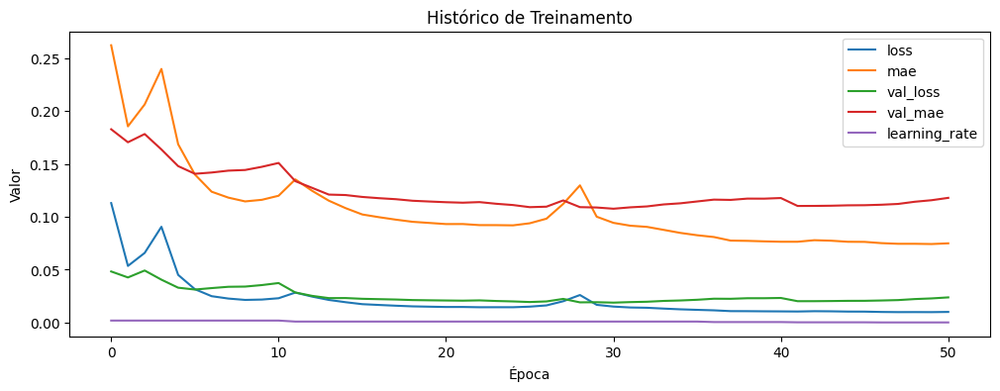

✅ Finished Nivel 2 - A - memory cleared
------------------------------------------------------------

🚀 Running pipeline Nivel 2 - B ...
[DIVIDIDO] train: 24,222 linhas
[DIVIDIDO] val: 8,074 linhas
[DIVIDIDO] test: 8,075 linhas


C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[col].shift(k)
C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[col].shift(k)
C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

[💾] Parquet salvo em: data/N2B\linear_model\linear_dataset_train.parquet
[✅] TFRecords salvos (20 shards) + Parquet em data/N2B\linear_model
[💾] Parquet salvo em: data/N2B\linear_model\linear_dataset_val.parquet
[✅] TFRecords salvos (4 shards) + Parquet em data/N2B\linear_model
[💾] Parquet salvo em: data/N2B\linear_model\linear_dataset_test.parquet


[I 2025-10-31 09:28:18,352] A new study created in memory with name: no-name-9b978204-8f5a-4ee9-883f-4496d1df6467


[✅] TFRecords salvos (3 shards) + Parquet em data/N2B\linear_model
Pré-processamento linear concluído.
Dataset TFRecord carregado para treinamento.


c:\Users\victo\OneDrive\Documentos\TCC\TCC-2025\tfc_venv\Lib\site-packages\keras\src\trainers\epoch_iterator.py:164: UserWarning: Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches. You may need to use the `.repeat()` function when building your dataset.
  self._interrupted_warning()
[I 2025-10-31 09:30:32,886] Trial 3 finished with value: 0.0361998975276947 and parameters: {'n_layers': 1, 'units_l0': 128, 'activation': 'tanh', 'dropout': 0.014630876375433276, 'l2': 1.4087220411855026e-05, 'lr': 0.0015731980612995996, 'n_epochs': 89}. Best is trial 3 with value: 0.0361998975276947.
[I 2025-10-31 09:30:40,239] Trial 9 finished with value: 0.015736492350697517 and parameters: {'n_layers': 2, 'units_l0': 32, 'units_l1': 352, 'activation': 'tanh', 'dropout': 0.2559367192645193, 'l2': 1.3691046953678771e-06, 'lr': 0.0006412233391502302, 'n_epochs': 98}. Best is trial 9 with value: 0.01573649235

Melhores hiperparâmetros Optuna: {'n_layers': 1, 'units_l0': 128, 'activation': 'leaky_relu', 'dropout': 0.03540397781315383, 'l2': 2.236057556563877e-06, 'lr': 0.0003160690433456014, 'n_epochs': 87}
Epoch 1/100
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 0.0734 - mae: 0.2026 - val_loss: 0.0635 - val_mae: 0.2119 - learning_rate: 3.1607e-04
Epoch 2/100
75/75 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - loss: 0.0301 - mae: 0.1364 - val_loss: 0.0421 - val_mae: 0.1686 - learning_rate: 3.1607e-04
Epoch 3/100
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0252 - mae: 0.1246 - val_loss: 0.0315 - val_mae: 0.1436 - learning_rate: 3.1607e-04
Epoch 4/100
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.0224 - mae: 0.1172 - val_loss: 0.0224 - val_mae: 0.1189 - learning_rate: 3.1607e-04
Epoch 5/100
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 7ms/step - loss: 0.0198 - mae: 0.1095 - val_loss: 0.0197 - val_mae: 0.1119 - learning_rate: 3.1607e-04
Epoch 6/100
75/75 ━━━━━━━━━━━━━━━━━━━━ 1s 6ms/step - loss: 0.0174 - mae: 0.

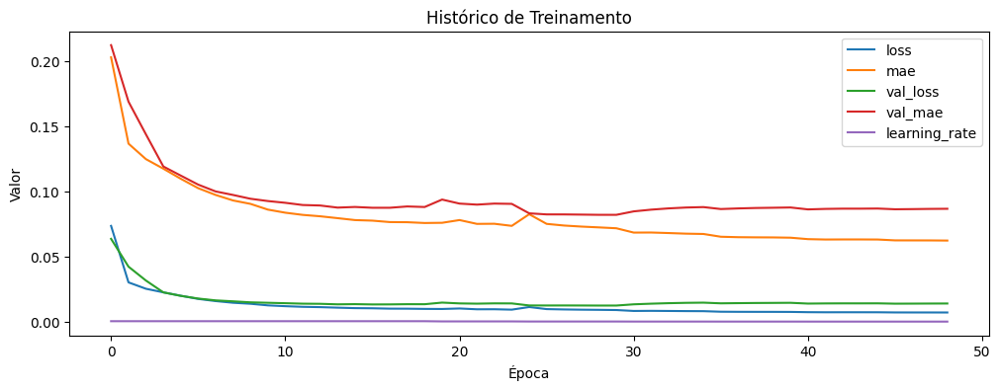

✅ Finished Nivel 2 - B - memory cleared
------------------------------------------------------------

🚀 Running pipeline Nivel 2 - C ...
[DIVIDIDO] train: 24,222 linhas
[DIVIDIDO] val: 8,074 linhas
[DIVIDIDO] test: 8,075 linhas


C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[col].shift(k)
C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df[cname] = df.groupby("_group_id", group_keys=False, sort=False)[col].shift(k)
C:\Users\victo\AppData\Local\Temp\ipykernel_32068\1621953328.py:52: PerformanceWarning: DataFrame is highly fragmented.  This is usually the resul

[WARN] Falha ao salvar Parquet: [Errno 28] Error writing bytes to file. Detail: [errno 28] No space left on device


UnicodeDecodeError: 'utf-8' codec can't decode byte 0xe7 in position 133: invalid continuation byte

In [18]:
import os, gc, tensorflow as tf

linear_pipelines = [
    dict(name="Nivel 1 - A", data_dir="data/N1A", feats=["country","datetime","quantity_MW"], tgts=["quantity_MW"], lag=7*96, lead=96, vals=["quantity_MW"], countries=["ES"]),
    dict(name="Nivel 1 - B", data_dir="data/N1B", feats=["country","datetime","quantity_MW"], tgts=["quantity_MW"], lag=15*96, lead=3*96, vals=["quantity_MW"], countries=COUNTRY_DOMAINS.keys()),
    dict(name="Nivel 1 - C", data_dir="data/N1C", feats=["country","datetime","quantity_MW"], tgts=["quantity_MW"], lag=30*96, lead=7*96, vals=["quantity_MW"], countries=COUNTRY_DOMAINS.keys()),
    dict(name="Nivel 2 - A", data_dir="data/N2A", feats=["country","datetime","quantity_MW","price_EUR_MWh"], tgts=["quantity_MW","price_EUR_MWh"], lag=7*96, lead=96, vals=["quantity_MW","price_EUR_MWh"], countries=["ES"]),
    dict(name="Nivel 2 - B", data_dir="data/N2B", feats=["country","datetime","quantity_MW","price_EUR_MWh"], tgts=["quantity_MW","price_EUR_MWh"], lag=15*96, lead=3*96, vals=["quantity_MW","price_EUR_MWh"], countries=COUNTRY_DOMAINS.keys()),
    dict(name="Nivel 2 - C", data_dir="data/N2C", feats=["country","datetime","quantity_MW","price_EUR_MWh"], tgts=["quantity_MW","price_EUR_MWh"], lag=30*96, lead=7*96, vals=["quantity_MW","price_EUR_MWh"], countries=COUNTRY_DOMAINS.keys())
]

for cfg in linear_pipelines:
    name = cfg["name"]     
    print(f"\n🚀 Running pipeline {name} ...")

    preproc, _ = linear_pipeline(
        data_dir=cfg["data_dir"],
        feature_cols=cfg["feats"],
        target_cols=cfg["tgts"],
        lag=cfg["lag"],
        lead=cfg["lead"],
        value_cols=cfg["vals"],
        country_list=cfg["countries"],
        batch_size=256
)

    del preproc
    tf.keras.backend.clear_session()
    gc.collect()


    print(f"✅ Finished {name} - memory cleared\n{'-'*60}")